# Problem 2: Visualize an interactive map (10 points)

Create a nice interactive map using the skills you leared in lesson 5: interactive maps using Folium (or some other suitable package - feel free to experiment!). Write your code into a notebook file (.ipynb) or a python script file (.py) and store the output map(s) in .html format under the docs folder.

Topic of the map:

You can select the topic of the map freely.
This map should not be only an interactive version of your submission for problem 1 ;). Create something new!
Feel free to adapt examples provided in this course!
Criteria:

The map should have multiple layers on it and/or present an output of (simple) data analysis (something beyond plotting raw data on a map).
Consider good cartographic practices
The map should demonstrate skills learned during lesson 5: interactive maps and throughout this course.
Think about including additional interactive elements, such as popup text in the map.
Output:

Remember to commit the code and input data (or at least a link to input data)
Save your map(s) in .html format in the docs folder

In [1]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from pyproj import CRS
import os
from shapely.geometry import LineString, Point, Polygon

In [2]:
directory = r"data_e4"
grid_file = r"MetropAccess_YKR_grid_EurefFIN.shp"
grid_path = os.path.join(directory, grid_file)


list_of_files = os.listdir(directory)
list_of_travel_time_files = []

for file in list_of_files:
    if '.txt' in file:
        list_of_travel_time_files.append(os.path.join(directory, file))

print(list_of_travel_time_files, " length of: ", len(list_of_travel_time_files) )

['data_e4\\TravelTimes_to_5878070_Jumbo.txt', 'data_e4\\TravelTimes_to_5878087_Dixi.txt', 'data_e4\\TravelTimes_to_5902043_Myyrmanni.txt', 'data_e4\\TravelTimes_to_5944003_Itis.txt', 'data_e4\\TravelTimes_to_5975373_Forum.txt', 'data_e4\\TravelTimes_to_5978593_IsoOmena.txt', 'data_e4\\TravelTimes_to_5980260_Ruoholahti.txt']  length of:  7


In [5]:
shopping_center_example = list_of_files[8].split('_')[3][:-4]

shopping_center_names_list = []

#repeat for all shopping centers
for shopping_center in list_of_travel_time_files:
    shopping_center_names_list.append( shopping_center.split('_')[4][:-4] )

print(shopping_center_names_list)

['Jumbo', 'Dixi', 'Myyrmanni', 'Itis', 'Forum', 'IsoOmena', 'Ruoholahti']


In [7]:
#read in grid shapefile
grid = gpd.read_file(grid_path)

#transform the crs of grid shapefile before performing the aggregation of geometry features using 'dissolve' (after dissolving, cant transform crs of multipolygon feature)
grid = grid.to_crs(CRS.from_epsg(3879))

#read each txt file as a data frame store in the list
for file, shopping_center in zip(list_of_travel_time_files, shopping_center_names_list):
    
    data = pd.read_csv(file, sep=';') 
    
    #generate new column name
    title_string = 'pt_r_t_{val}'.format(val = shopping_center)
    
    #create a new column using values from the 'pt_r_t' column
    data[title_string] = data[ [ 'pt_r_t' ] ] 
    
    data.drop(columns=['pt_r_t'], axis=1, inplace=True)
    
    #create a smaller subset of data, join both tables using YKR_ID from grid and from_id of data, overwrite the previous dataframe
    grid = grid.merge(data[ [title_string, 'from_id'] ],  how='outer', left_on = 'YKR_ID', right_on ='from_id')
    
    grid.drop(columns = ['from_id'], axis=1, inplace=True)

In [9]:
columns_for_comparison = grid.columns[4:]

#extract the min value from current row
row_min =  grid[ columns_for_comparison ].idxmin(axis='columns',skipna=True)

#test row_min
print(len(row_min))

dominant_service = []
min_t = []
for index in range(0,len(row_min)):
    min_t.append( grid.at[index, row_min[index]] )
    dominant_service.append( row_min[index].split('_')[3])

13231


In [10]:
grid['min_t'] = min_t
grid['dominant_service'] = dominant_service

In [11]:
import numpy as np

#more efficient way of removing null values from dataframe
grid.replace(-1, np.nan, inplace=True)

#drop NA values if there any NA values in thw row, do not make a copy of the instance.
grid.dropna(axis=0, how='any', inplace=True)

grid.reset_index( inplace=True)

print("simplified NA removal: " , len(grid))

simplified NA removal:  13020


In [12]:
# NON-EDITABLE TEST CELL
print(grid[['YKR_ID', 'min_t', 'dominant_service']].head())

    YKR_ID  min_t dominant_service
0  5785640   90.0        Myyrmanni
1  5785641   93.0        Myyrmanni
2  5785642   95.0        Myyrmanni
3  5785643   99.0        Myyrmanni
4  5787544   83.0        Myyrmanni


In [13]:
#dissolve (aggregate geometries - municipality polygon geometries for each shopping center
dominant_service_area = grid.dissolve(by='dominant_service')
    
dominant_service_area.reset_index(inplace=True)

#Select useful columns
dominant_service_area  = dominant_service_area[['dominant_service', "geometry"]]

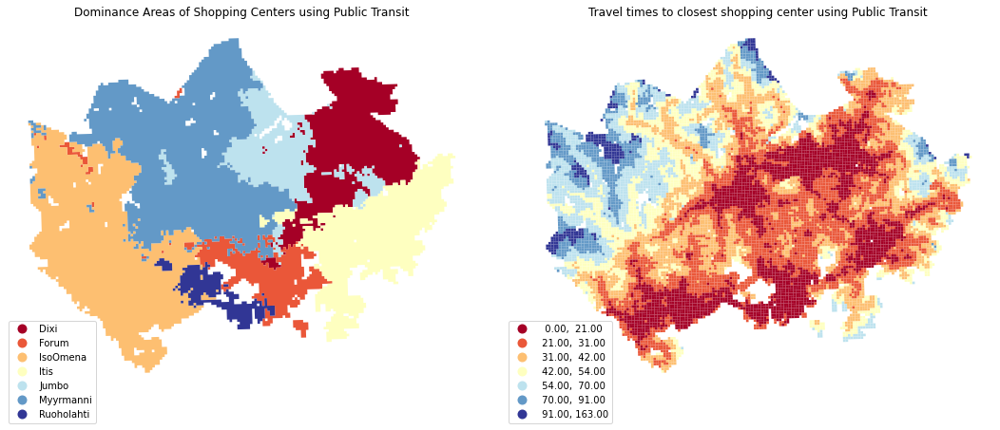

In [14]:
#how to adjust legend of a plot reference:
#https://stackoverflow.com/questions/39816790/relocating-legend-from-geopandas-plot

import matplotlib.pyplot as plt

#increase the overall figsize to allow the subplots to increase in fig_size
fig, axs = plt.subplots(nrows = 1, ncols=2, sharex=True, sharey=True, figsize= (15,15))


plot1 = dominant_service_area.plot(ax=axs[0], column='dominant_service',cmap="RdYlBu",k=7, linewidth=0, legend =True, figsize=(10, 5)) #plot a different color for each grid x 20 grids
plot1.set_title("Dominance Areas of Shopping Centers using Public Transit")
plot1.axis('off')
leg1 = plot1.get_legend()
leg1.set_bbox_to_anchor((0., 0., 0.2, 0.2))

plot2 = grid.plot(ax = axs[1], column= "min_t", scheme= "Natural_Breaks", k=7, cmap="RdYlBu", linewidth=0, legend = True, figsize=(10, 5))
plot2.set_title("Travel times to closest shopping center using Public Transit")
plot2.axis('off')

leg2 = plot2.get_legend()
leg2.set_bbox_to_anchor((0., 0., 0.2, 0.2))

plt.tight_layout()
plt.show()

In [15]:
import folium

- Add tooltip for each dominant service area

In [32]:
#create a map instance
m1 = folium.Map(location=[60.25, 24.8], tiles='cartodbpositron', zoom_start=11, control_scale = True)

dominance_area_gjson = folium.features.GeoJson(dominant_service_area, name="Dominant Shopping Area Zones").add_to(m1)

# Convert points to GeoJson
folium.features.GeoJson(dominant_service_area,  
                        name='Labels',
                        style_function=lambda x: {'color':'transparent','fillColor':'transparent','weight':0},
                        tooltip=folium.features.GeoJsonTooltip(fields=['dominant_service'],
                                                                aliases = ['Minimum Travel_Time by Public Transit'],
                                                                labels=True,
                                                                sticky=False
                                                                            )
                       ).add_to(m1)

m1

- Add tool tips to minimum travel time grids

In [33]:
#create a map instance
m2 = folium.Map(location=[60.25, 24.8], tiles='cartodbpositron', zoom_start=11, control_scale = True)

# Create a Geo-id which is needed by the Folium (it needs to have a unique identifier for each row)
grid['geoid'] = grid.index.astype(str)

# Plot a choropleth map for min_t
# Notice: 'geoid' column that we created earlier needs to be assigned always as the first column
folium.Choropleth(
    geo_data=grid,
    name='Minimum Travel Time By Public Transit',
    data=grid,
    columns=['geoid', 'min_t'],
    key_on='feature.id',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    line_color='white', 
    line_weight=0,
    highlight=False, 
    smooth_factor=1.0,
    #threshold_scale=[100, 250, 500, 1000, 2000],
    legend_name= 'Minimum Travel Time By Public Transit').add_to(m2)

# Add 'invisible layer' to act as a tooltip for the grid displaying minimum travel time.
folium.features.GeoJson(grid,  
                        name='Labels',
                        style_function=lambda x: {'color':'transparent','fillColor':'transparent','weight':0},
                        tooltip=folium.features.GeoJsonTooltip(fields=['min_t'],
                                                                aliases = ['Minimum Travel_Time by Public Transit'],
                                                                labels=True,
                                                                sticky=False
                                                                            )
                       ).add_to(m2)

m2

In [34]:
fp = 'dominant_service_area.html'
fp2 = 'min_travel_time_by_public_transit.html'
m1.save(fp)
m2.save(fp2)